# Aggregate TFIDF

```yaml
course:   DS 5001 
module:   05 5 Lab
topic:    Aggregate TFIDF
author:   R.C. Alvarado
date:     13 February 2024
```

# Overview

Recall Luhn's (1958) representation of the problem:

<img src="luhn.png"/>

In this notebook, we look at ways to approximate Luhn's significance curve using the ideas we learned in this module.

# Set Up

## Import

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly_express as px

In [2]:
sns.set()

## Config

Change this to match the location of your data files.

In [3]:
import configparser
config = configparser.ConfigParser()
config.read("../../../env.ini")
data_home = config['DEFAULT']['data_home'] 
output_dir = config['DEFAULT']['output_dir']
data_prefix = 'austen-melville'

In [4]:
OHCO = ['book_id', 'chap_num', 'para_num', 'sent_num', 'token_num']
bags = dict(
    SENTS = OHCO[:4],
    PARAS = OHCO[:3],
    CHAPS = OHCO[:2],
    BOOKS = OHCO[:1]
)

In [48]:
# bag = 'BOOKS'
bag = 'CHAPS'

# Prepare the data

## Import tables

In [49]:
LIB = pd.read_csv(f"{output_dir}/{data_prefix}-LIB.csv").set_index('book_id')
TOKEN = pd.read_csv(f'{output_dir}/{data_prefix}-TOKEN.csv').set_index(OHCO).dropna()
VOCAB = pd.read_csv(f'{output_dir}/{data_prefix}-VOCAB-{bag}.csv').set_index('term_str').dropna()
BOW = pd.read_csv(f'{output_dir}/{data_prefix}-BOW-{bag}.csv').set_index(bags[bag]+['term_str'])
DTCM = pd.read_csv(f'{output_dir}/{data_prefix}-DTCM-{bag}.csv').set_index(bags[bag]) 
TFIDF = pd.read_csv(f'{output_dir}/{data_prefix}-TFIDF-{bag}.csv').set_index(bags[bag])
DOC = pd.read_csv(f'{output_dir}/{data_prefix}-DOC-{bag}.csv').set_index(bags[bag])

# Apply aggregates to VOCAB

In [50]:
VOCAB['tfidf_mean'] = TFIDF.mean() 
VOCAB['tfidf_sum'] = TFIDF.sum()

## Add DFIDF and DH

Instead of aggregating TFIDF values, try estimating the their weights over documents directly.

Do this in two ways:

1. Based on a variation on the TF-IDF formula.
2. Just estimate the entropy of terms over documents.

In [52]:
VOCAB['dfidf'] = VOCAB.df * VOCAB.idf
VOCAB['dp'] = VOCAB.df / len(DOC)
VOCAB['di'] = np.log2(1/VOCAB.dp)
VOCAB['dh'] = VOCAB.dp * VOCAB.di

## Observe results

In [66]:
VOCAB.sample(25).sort_values('di', ascending=True)[['max_pos', 'n', 'i','tfidf_mean','tfidf_sum', 'dfidf', 'di', 'dh']]\
    .style.background_gradient(cmap='YlGnBu')

,max_pos,n,i,tfidf_mean,tfidf_sum,dfidf,di,dh
term_str,,,,,,,,
shortly,RB,121,14.054620,0.000204,0.228411,360.817270,3.403937,0.321584
cares,NNS,64,14.973483,0.000114,0.127767,242.172114,4.324502,0.215840
strip,NN,37,15.764030,0.000131,0.146814,156.748991,5.224966,0.139705
sheltered,VBN,24,16.388520,0.000050,0.056546,111.794659,5.883929,0.099639
cripple,NN,39,15.688081,0.000093,0.104344,107.314775,5.961932,0.095646
darts,NNS,11,17.514051,0.000030,0.033818,73.396679,6.672425,0.065416
preservative,JJ,7,18.166128,0.000034,0.038199,45.281367,7.546894,0.040358
marlowe,NNP,10,17.651555,0.000049,0.054770,39.049644,7.809929,0.034804
exhort,VB,4,18.973483,0.000014,0.015707,32.527428,8.131857,0.028991


# Visualize

Try to pick the best aggregate statistic.

## Information and TFIDF Mean 

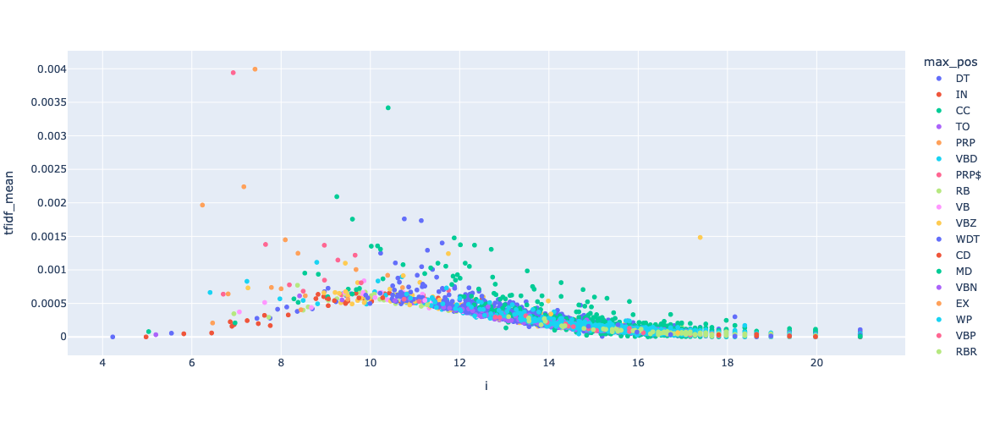

In [69]:
px.scatter(VOCAB.reset_index(), x='i', y='tfidf_mean', 
           hover_name='term_str', hover_data=['n'], color='max_pos', 
           log_x=False, log_y=False, height=500, width=700)

## Information and TFIDF Sum

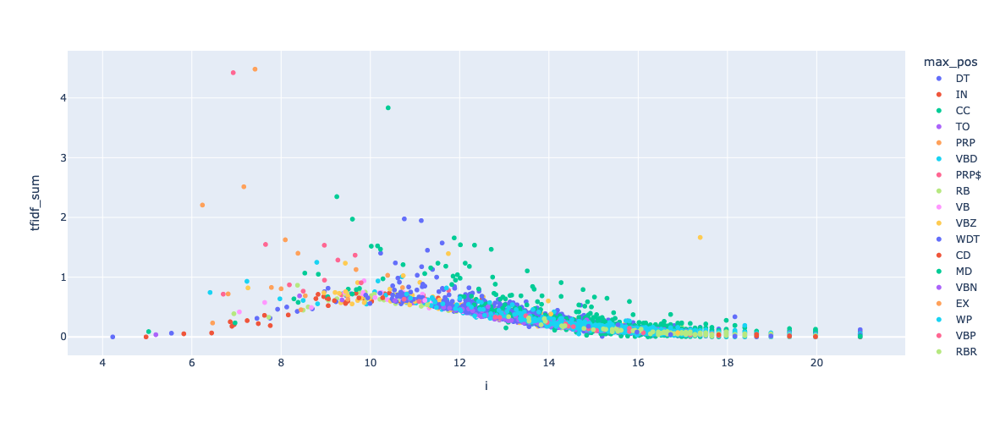

In [70]:
px.scatter(VOCAB.reset_index(), x='i', y='tfidf_sum', 
           hover_name='term_str', hover_data=['n'], color='max_pos', 
           height=500, width=700)

## Information and DFIDF

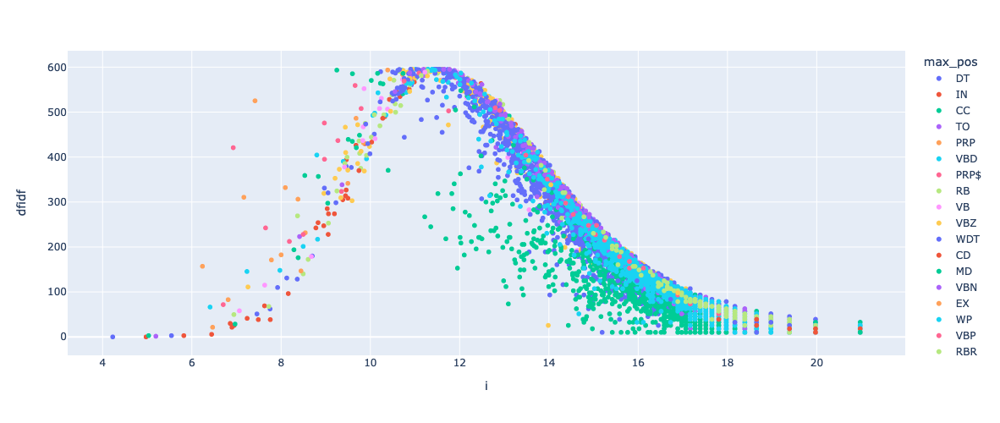

In [85]:
px.scatter(VOCAB.reset_index(), x='i', y='dfidf', 
           hover_name='term_str', hover_data=['n'], 
           color='max_pos', height=500, width=800)

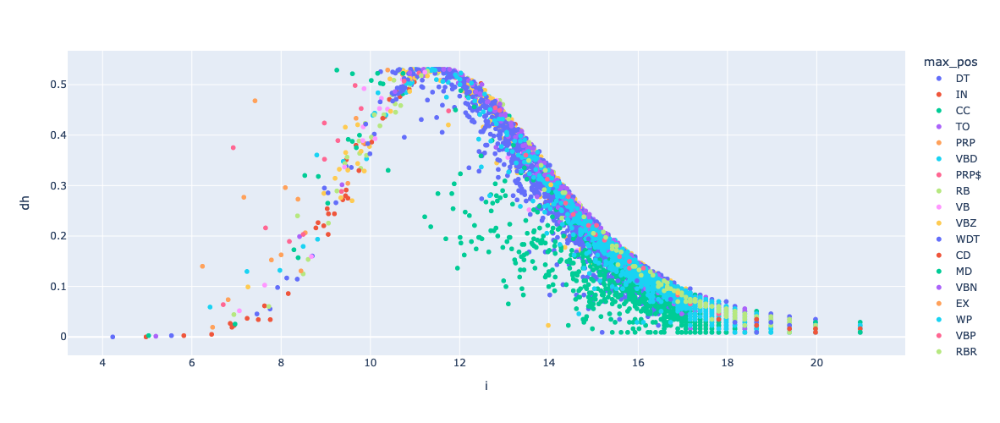

In [84]:
px.scatter(VOCAB.reset_index(), x='i', y='dh', 
           hover_name='term_str', hover_data=['n'], 
           color='max_pos', height=500, width=800)

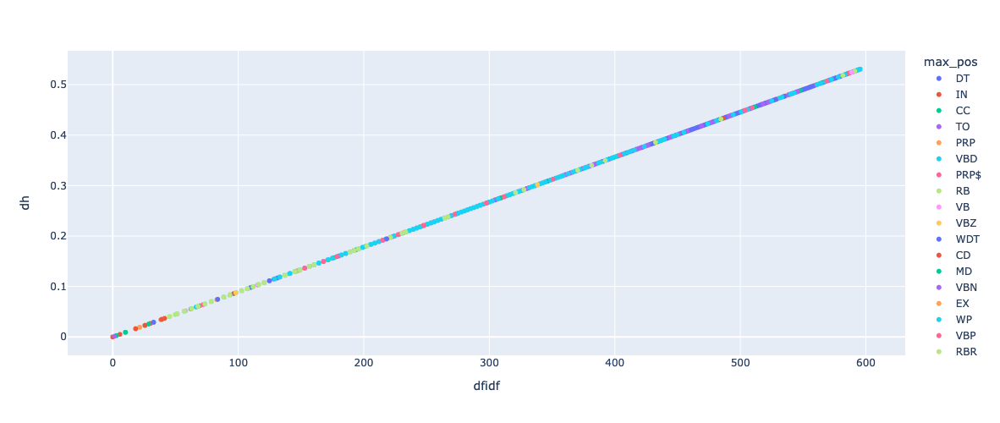

In [83]:
px.scatter(VOCAB.reset_index(), x='dfidf', y='dh', 
           hover_name='term_str', hover_data=['n'], 
           color='max_pos', height=500, width=700)

## Demo Table

In [74]:
rank_index = [1, 2, 3, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000]

In [75]:
demo2 = VOCAB.loc[VOCAB.term_rank.isin(rank_index), 
                  ['max_pos', 'i', 'tfidf_mean', 'tfidf_sum', 'dfidf', 'dh']]

In [76]:
demo2.style.background_gradient(cmap='YlGnBu')

,max_pos,i,tfidf_mean,tfidf_sum,dfidf,dh
term_str,,,,,,
the,DT,4.227375,0.000000,0.000000,0.000000,0.000000
of,IN,4.973725,0.000000,0.000000,0.000000,0.000000
and,CC,5.031473,0.000079,0.088788,2.882817,0.002569
it,PRP,6.465503,0.000208,0.233208,21.495121,0.019158
you,PRP,7.165021,0.002240,2.513699,310.618692,0.276844
so,RB,7.724073,0.000293,0.329229,67.746505,0.060380
their,PRP$,8.184357,0.000777,0.871750,212.307769,0.189223
are,VBP,8.495725,0.000683,0.766291,228.069595,0.203271
will,MD,8.833292,0.000935,1.049116,356.913125,0.318104


# Reduce VOCAB

## Select Significant Terms based on DFIDF

In [77]:
len(VOCAB)

39842

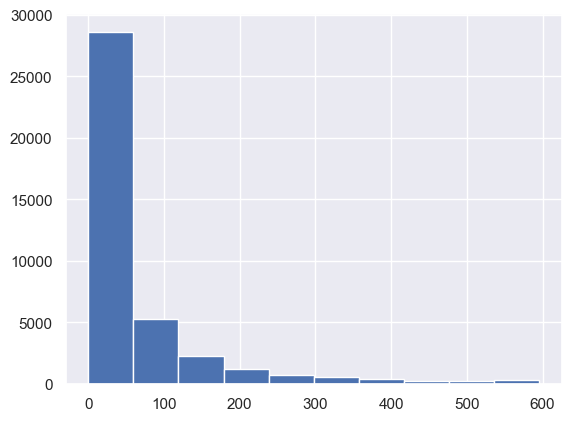

In [78]:
VOCAB.dfidf.hist();

In [79]:
SIGS = VOCAB.sort_values('dfidf', ascending=False).head(4000)

In [80]:
SIGS[['max_pos', 'n', 'i', 'dh']].head(25).style.background_gradient(cmap='YlGnBu')

,max_pos,n,i,dh
term_str,,,,
hands,NNS,771,11.382896,0.530737
sure,JJ,1047,10.941437,0.530737
short,JJ,699,11.524334,0.530735
new,JJ,763,11.397944,0.530726
word,NN,725,11.471646,0.530726
passed,VBN,696,11.530539,0.530722
fine,JJ,719,11.483635,0.530716
name,NN,724,11.473637,0.530710
sight,NN,687,11.549317,0.530702


# Save Work

In [81]:
save_path = f"{output_dir}/{data_prefix}"
# VOCAB.to_csv(f'{save_path}-VOCAB-{bag}.csv')
# TOKEN.to_csv(f'{save_path}-TOKEN2.csv')
# BOW.to_csv(f'{save_path}-BOW-{bag}.csv')
# DTCM.to_csv(f'{save_path}-DTCM-{bag}.csv')
# TFIDF.to_csv(f'{save_path}-TFIDF-{bag}.csv')
SIGS.to_csv(f'{save_path}-SIGS-{bag}.csv')
TFIDF[SIGS.index].to_csv(f'{save_path}-TFIDF_REDUCED-{bag}.csv')
# DOC.to_csv(f'{save_path}-CHAP_STATS.csv')